# <center>Freesound General-Purpose Audio Tagging Challenge</center>

![Logo](https://upload.wikimedia.org/wikipedia/commons/3/3c/Freesound_project_website_logo.png)

Freesound is a collaborative database of Creative Commons Licensed sounds. The aim of this competition is to classify audio files that cover real-world sounds from musical instruments, humans, animals, machines, etc. Few of the labels are: `Trumpet`, `Squeak`, `Meow`, `Applause` and `Finger_sapping`.  One of the challenges is that not all labels are manually verified. A creative solution should be able to partially rely on these *weak* annotations.



### Contents
1. [Exploratory Data Analysis](#eda)
    * [Loading data](#loading_data)
    * [Distribution of Categories](#distribution)
    * [Manually Verified](#manullayverified)
    * [Reading Audio Files](#audio_files)
    * [Audio Length](#audio_length)
    * [Waveform](#waveform)
    * [Spectrogram](#spectrogram)


<a id="eda"></a>
## <center>1. Exploratory Data Analysis</center>

In [73]:
import os
import shutil

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
np.random.seed(42)

from scipy.io import wavfile
from scipy.fftpack import fft
from scipy import signal
from scipy.io import wavfile
import librosa
import wave

import IPython
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
color = sns.color_palette()
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.offline as offline
offline.init_notebook_mode()
import plotly.tools as tls


from tqdm import tqdm_notebook
import IPython.display as ipd  # To play sound in the notebook

import warnings
warnings.filterwarnings('ignore')

%matplotlib inline
matplotlib.style.use('ggplot')

In [2]:
SAMPLE_RATE = 44100

In [3]:
!ls ../data/freesound-audio-tagging/input/

audio_test   sample_submission.csv	train_post_competition.csv
audio_train  test_post_competition.csv
README.md    train.csv


In [4]:
TRAIN_DATA_PATH = "../data/freesound-audio-tagging/input/"

In [5]:
train = pd.read_csv("../data/freesound-audio-tagging/input/train.csv")
test = pd.read_csv("../data/freesound-audio-tagging/input/sample_submission.csv")

In [6]:
train.head()

,fname,label,manually_verified
0,00044347.wav,Hi-hat,0
1,001ca53d.wav,Saxophone,1
2,002d256b.wav,Trumpet,0
3,0033e230.wav,Glockenspiel,1
4,00353774.wav,Cello,1


In [7]:
print("Number of training examples=", train.shape[0], "  Number of classes=", len(train.label.unique()))

Number of training examples= 9473   Number of classes= 41


In [8]:
print(train.label.unique())

['Hi-hat' 'Saxophone' 'Trumpet' 'Glockenspiel' 'Cello' 'Knock'
 'Gunshot_or_gunfire' 'Clarinet' 'Computer_keyboard' 'Keys_jangling'
 'Snare_drum' 'Writing' 'Laughter' 'Tearing' 'Fart' 'Oboe' 'Flute' 'Cough'
 'Telephone' 'Bark' 'Chime' 'Bass_drum' 'Bus' 'Squeak' 'Scissors'
 'Harmonica' 'Gong' 'Microwave_oven' 'Burping_or_eructation' 'Double_bass'
 'Shatter' 'Fireworks' 'Tambourine' 'Cowbell' 'Electric_piano' 'Meow'
 'Drawer_open_or_close' 'Applause' 'Acoustic_guitar' 'Violin_or_fiddle'
 'Finger_snapping']


<a id="distribution"></a>
### Distribution of Categories

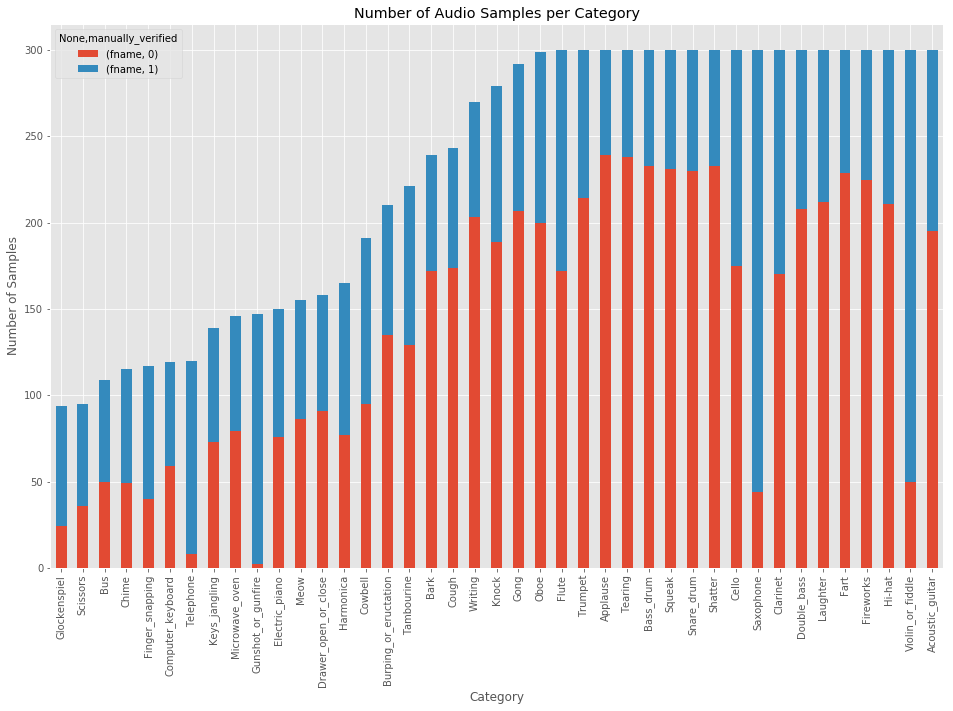

In [9]:
category_group = train.groupby(['label', 'manually_verified']).count()
plot = category_group.unstack().reindex(category_group.unstack().sum(axis=1).sort_values().index)\
          .plot(kind='bar', stacked=True, title="Number of Audio Samples per Category", figsize=(16,10))
plot.set_xlabel("Category")
plot.set_ylabel("Number of Samples");

In [10]:
print('Minimum samples per category = ', min(train.label.value_counts()))
print('Maximum samples per category = ', max(train.label.value_counts()))

Minimum samples per category =  94
Maximum samples per category =  300


Total number of labels in training data :  41
Labels are :  ['Hi-hat' 'Saxophone' 'Trumpet' 'Glockenspiel' 'Cello' 'Knock'
 'Gunshot_or_gunfire' 'Clarinet' 'Computer_keyboard' 'Keys_jangling'
 'Snare_drum' 'Writing' 'Laughter' 'Tearing' 'Fart' 'Oboe' 'Flute' 'Cough'
 'Telephone' 'Bark' 'Chime' 'Bass_drum' 'Bus' 'Squeak' 'Scissors'
 'Harmonica' 'Gong' 'Microwave_oven' 'Burping_or_eructation' 'Double_bass'
 'Shatter' 'Fireworks' 'Tambourine' 'Cowbell' 'Electric_piano' 'Meow'
 'Drawer_open_or_close' 'Applause' 'Acoustic_guitar' 'Violin_or_fiddle'
 'Finger_snapping']


/home/mageswarand/anaconda3/envs/tensorflow1.0/lib/python3.6/site-packages/seaborn/categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



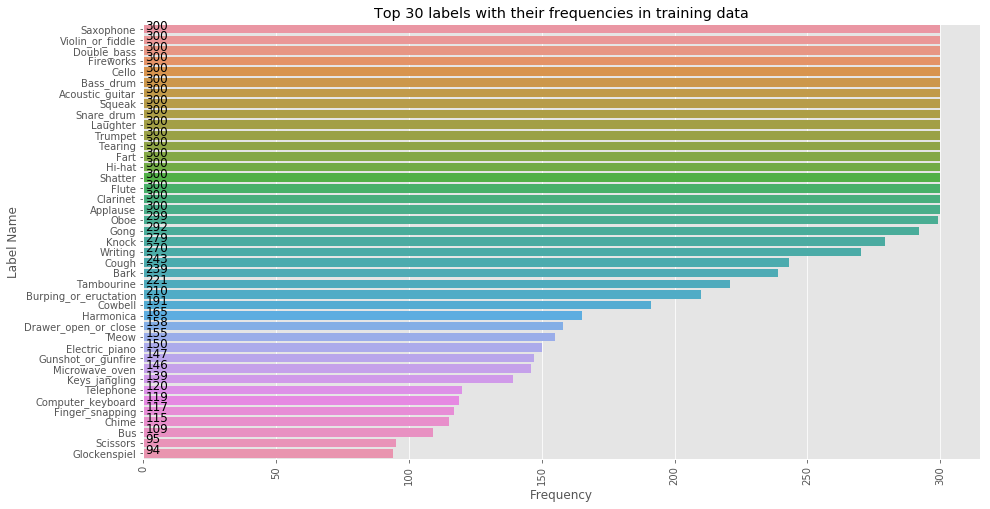

In [11]:
print("Total number of labels in training data : ",len(train['label'].value_counts()))
print("Labels are : ", train['label'].unique())

plt.figure(figsize=(15,8))
audio_type = train['label'].value_counts()
sns.barplot(audio_type.values, audio_type.index)

for i, v in enumerate(audio_type.values):
    plt.text(0.8,i,v,color='k',fontsize=12)

plt.xticks(rotation='vertical')
plt.xlabel('Frequency')
plt.ylabel('Label Name')
plt.title("Top 30 labels with their frequencies in training data")
plt.show()

<a id="manullayverified"></a>
### Manually verified Audio

In [12]:
temp = train['manually_verified'].value_counts()
labels = temp.index
sizes = (temp / temp.sum())*100
trace = go.Pie(labels=labels, values=sizes, hoverinfo='label+percent')
layout = go.Layout(title='Manually varification of labels(0 - No, 1 - Yes)')
data = [trace]
fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

We observe that:
1. The number of audio samples per category is **non-nform**. The minimum number of audio samples in a category is `94` while the maximum is `300`
2. Also, the proportion of `maually_verified` labels per category is non-uniform.
<a id="audio_files"></a>
### Reading Audio Files

The audios are [Pulse-code modulated](https://en.wikipedia.org/wiki/Audio_bit_depth) with a [bit depth](https://en.wikipedia.org/wiki/Audio_bit_depth) of 16 and a [sampling rate](https://en.wikipedia.org/wiki/Sampling_%28signal_processing%29) of 44.1 kHz

![16-bit PCM](https://upload.wikimedia.org/wikipedia/commons/thumb/b/bf/Pcm.svg/500px-Pcm.svg.png)

* **Bit-depth = 16**: The amplitude of each sample in the audio is one of 2^16 (=65536) possible values. 
* **Samplig rate = 44.1 kHz**: Each second in the audio consists of 44100 samples. So, if the duration of the audio file is 3.2 seconds, the audio will consist of 44100\*3.2 = 141120 values.

Let's listen to an audio file in our dataset and load it to a numpy array

In [69]:
! file ../data/freesound-audio-tagging/input/audio_train/00044347.wav

../data/freesound-audio-tagging/input/audio_train/00044347.wav: RIFF (little-endian) data, WAVE audio, Microsoft PCM, 16 bit, mono 44100 Hz


In [13]:
fname = '../data/freesound-audio-tagging/input/audio_train/' + '00044347.wav'   # Hi-hat
ipd.Audio(fname)

In [72]:
# Using wave library
import wave
wav = wave.open(fname)
raw_signal = wav.readframes(-1)
raw_signal = np.fromstring(raw_signal, 'Int16')
print("Sampling (frame) rate = ", wav.getframerate())
print("Frame Rate : ", wav.getframerate())
print()
print("Total samples (frames) = ", wav.getnframes())
print("len(raw_signal) : ", len(raw_signal))
print()
print("Number of channles = ", wav.getnchannels())
print()
print("Duration (secs) = ",  wav.getnframes()/wav.getframerate())

Sampling (frame) rate =  44100
Frame Rate :  44100

Total samples (frames) =  617400
len(raw_signal) :  617400

Number of channles =  1

Duration (secs) =  14.0


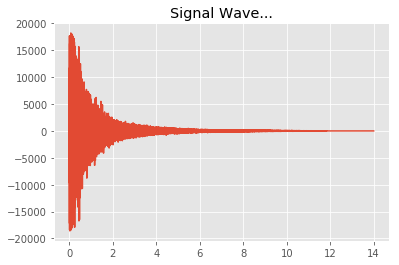

In [50]:
time = np.linspace(0, wav.getnframes()/wav.getframerate(), num=len(raw_signal))

plt.figure(1)
plt.title('Signal Wave...')
plt.plot(time,raw_signal)
plt.show()

In [57]:
# Using scipy
from scipy.io import wavfile
samplerate, data = wavfile.read(fname)
print("Sampling (frame) rate = ", samplerate)
print("Total samples (frames) = ", data.shape)
print("Duration :" , len(data)/samplerate)
print(data)

Sampling (frame) rate =  44100
Total samples (frames) =  (617400,)
Duration : 14.0
[ 0 26 -5 ...  1  0  0]


Let's plot the audio frames

In [ ]:
times = np.arange(len(data))/float(samplerate)
plt.figure(figsize=(30, 4))
plt.fill_between(times, data, color='b') 
plt.xlim(times[0], times[-1])
plt.xlabel('time (s)')
plt.ylabel('amplitude')

Text(0,0.5,'amplitude')

Let's zoom in on first 1000 frames

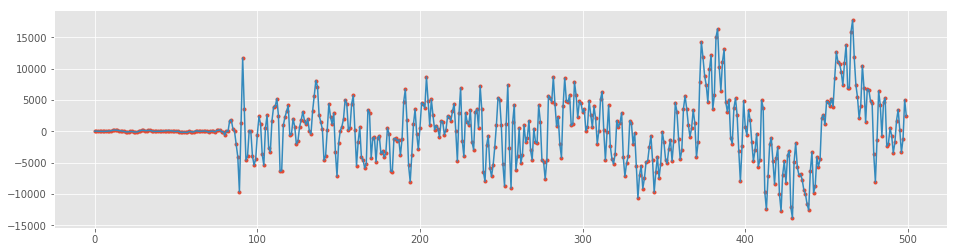

In [17]:
plt.figure(figsize=(16, 4))
plt.plot(data[:500], '.'); plt.plot(data[:500], '-');

<a id="audio_length"></a>
### Audio Length

We shall now analyze the lengths of the audio files in our dataset

/home/mageswarand/anaconda3/envs/tensorflow1.0/lib/python3.6/site-packages/seaborn/categorical.py:598: FutureWarning:

remove_na is deprecated and is a private function. Do not use.

/home/mageswarand/anaconda3/envs/tensorflow1.0/lib/python3.6/site-packages/seaborn/categorical.py:826: FutureWarning:

remove_na is deprecated and is a private function. Do not use.

/home/mageswarand/anaconda3/envs/tensorflow1.0/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning:

Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.



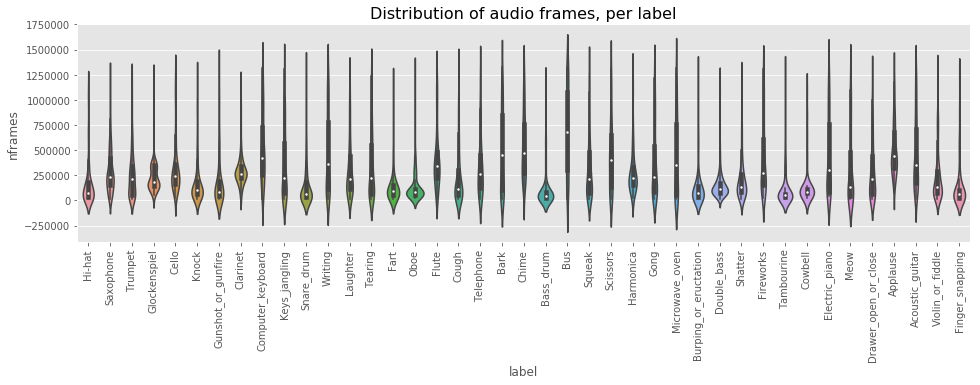

In [19]:
train['nframes'] = train['fname'].apply(lambda f: wave.open('../data/freesound-audio-tagging/input/audio_train/' + f).getnframes())
test['nframes'] = test['fname'].apply(lambda f: wave.open('../data/freesound-audio-tagging/input/audio_test/' + f).getnframes())

_, ax = plt.subplots(figsize=(16, 4))
sns.violinplot(ax=ax, x="label", y="nframes", data=train)
plt.xticks(rotation=90)
plt.title('Distribution of audio frames, per label', fontsize=16)
plt.show()

<a id="waveform"></a>
### Waveform
Lets see some wave forms

In [20]:
def load_wav_file(name, path):
    _, b = wavfile.read(path + name)
    assert _ == SAMPLE_RATE
    return b

In [29]:
def plot_wav_form(label):
    temp = train[train["label"] == label].head(16)
    temp['data'] = temp['fname'].apply(load_wav_file, path=TRAIN_DATA_PATH + '/audio_train/')  
    temp = temp.reset_index(drop=True)
    
    print(label)
    fig, ax = plt.subplots(4, 4, figsize = (12, 12))

    for i in range(16):
        ax[i//4, i%4].plot(temp['data'][i])
        ax[i//4, i%4].set_title(temp['fname'][i][:-4])
        ax[i//4, i%4].get_xaxis().set_ticks([])

    fig.savefig(label, dpi=900)   

Finger_snapping


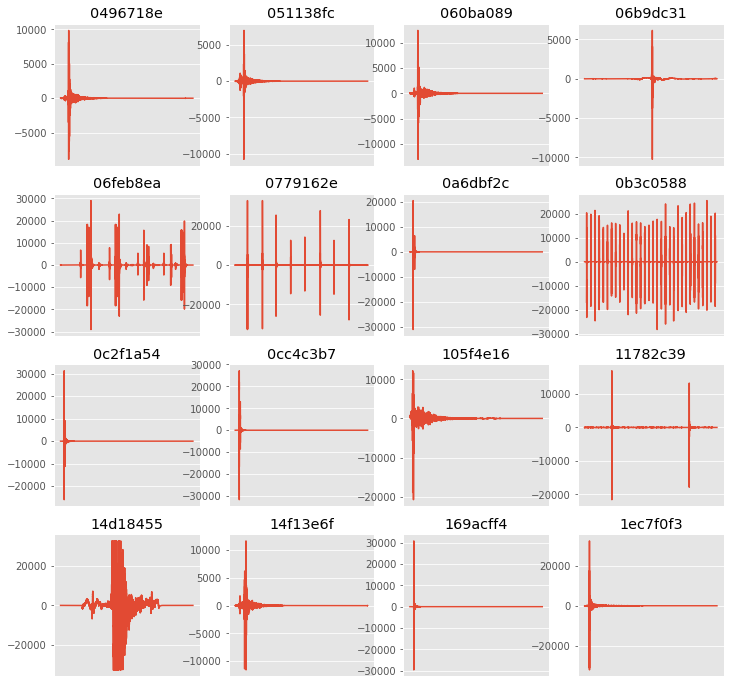

In [30]:
plot_wav_form("Finger_snapping")

Acoustic_guitar


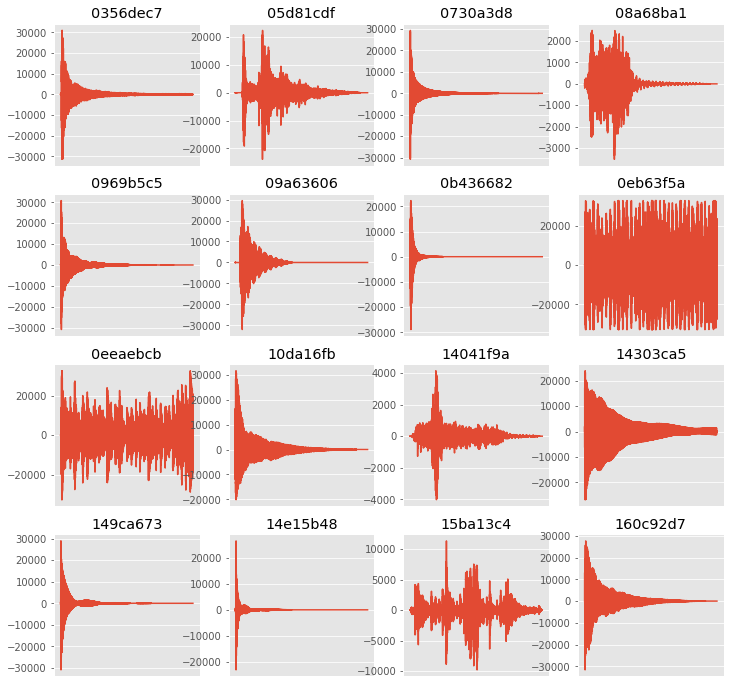

In [31]:
plot_wav_form("Acoustic_guitar")

Computer_keyboard


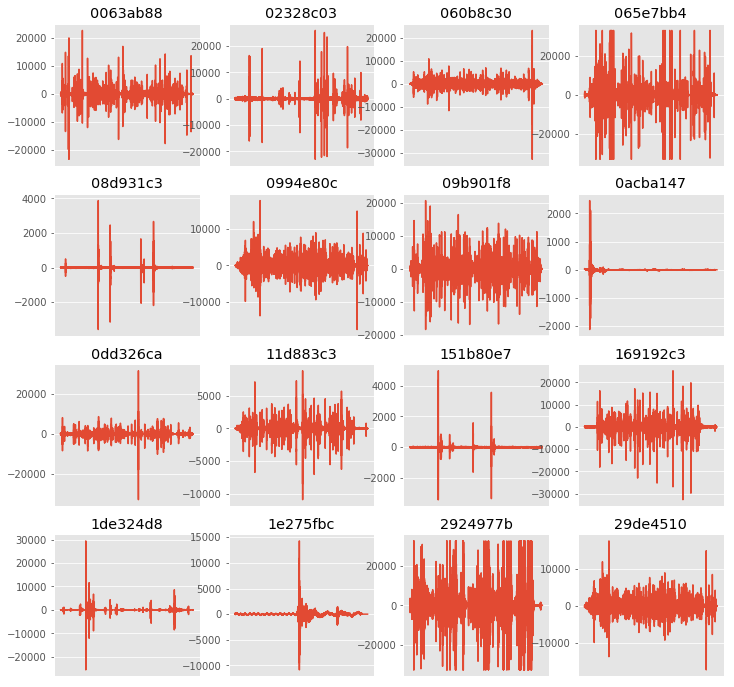

In [32]:
plot_wav_form("Computer_keyboard")

<a id="spectrogram"></a>
### Spectrogram

In [63]:
def log_specgram(audio, sample_rate, window_size=20,
                 step_size=10, eps=1e-10):
    nperseg = int(round(window_size * sample_rate / 1e3))
    noverlap = int(round(step_size * sample_rate / 1e3))
    freqs, times, spec = signal.spectrogram(audio,
                                    fs=sample_rate,
                                    window='hann',
                                    nperseg=nperseg,
                                    noverlap=noverlap,
                                    detrend=False)
    return freqs, times, np.log(spec.T.astype(np.float32) + eps)

In [65]:
filename = '/001ca53d.wav' # Hi-hat
sample_rate, samples = wavfile.read(str(TRAIN_DATA_PATH) + "audio_train/" + filename)

Text(0.5,0,'Seconds')

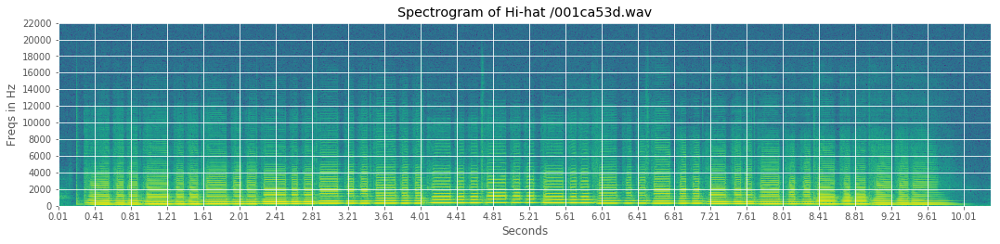

In [66]:
freqs, times, spectrogram = log_specgram(samples, sample_rate)

fig = plt.figure(figsize=(18, 8))
ax2 = fig.add_subplot(211)
ax2.imshow(spectrogram.T, aspect='auto', origin='lower', 
           extent=[times.min(), times.max(), freqs.min(), freqs.max()])
ax2.set_yticks(freqs[::40])
ax2.set_xticks(times[::40])
ax2.set_title('Spectrogram of Hi-hat ' + filename)
ax2.set_ylabel('Freqs in Hz')
ax2.set_xlabel('Seconds')

### Specgtrogram of "Hi-Hat" in 3d

In [67]:
mean = np.mean(spectrogram, axis=0)
std = np.std(spectrogram, axis=0)
spectrogram = (spectrogram - mean) / std

In [69]:
data = [go.Surface(z=spectrogram.T)]
layout = go.Layout(
    title='Specgtrogram of "Hi-Hat" in 3d',
    scene = dict(
    yaxis = dict(title='Frequencies', range=freqs),
    xaxis = dict(title='Time', range=times),
    zaxis = dict(title='Log amplitude'),
    ),
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig)